Apresentando o shape dos dados (dimenssoes)

(45211, 17)

Apresentando os tipos dos atributos

age           int64
job          object
marital      object
education    object
default      object
balance       int64
housing      object
loan         object
contact      object
day           int64
month        object
duration      int64
campaign      int64
pdays         int64
previous      int64
poutcome     object
y            object
dtype: object

Visualizando o conjunto inicial (head) dos dados, ou mais claramente, os 5 primeiros registros (head(5))

   age           job  marital  education default  balance housing loan  \
0   58    management  married   tertiary      no     2143     yes   no   
1   44    technician   single  secondary      no       29     yes   no   
2   33  entrepreneur  married  secondary      no        2     yes  yes   
3   47   blue-collar  married    unknown      no     1506     yes   no   
4   33       unknown   single    unknown      no        1      no   no   


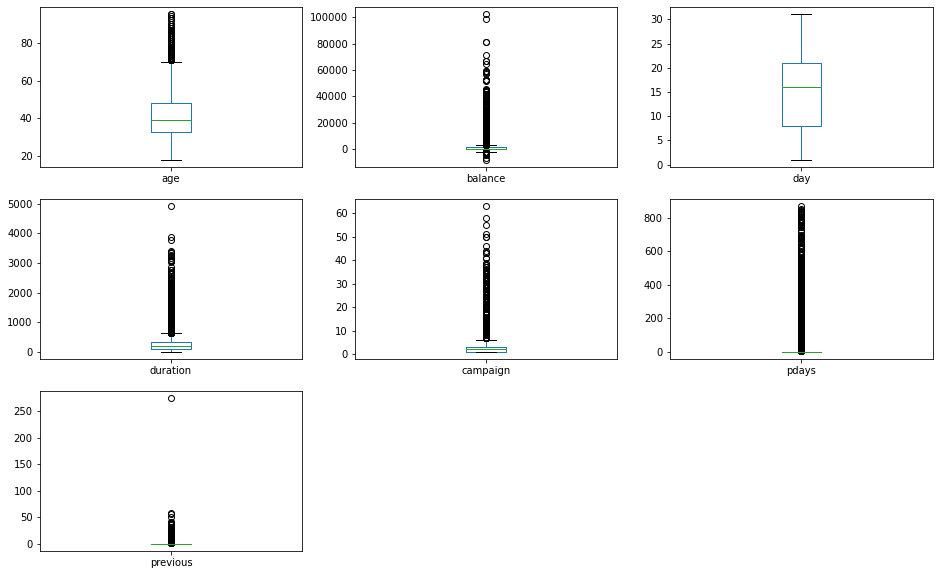

Criando histogramas dos dados por classes


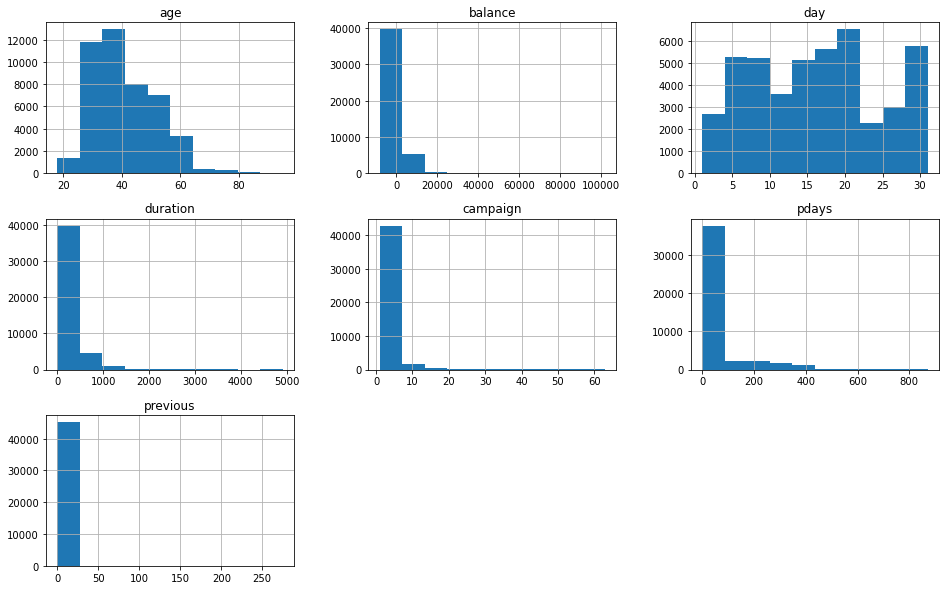

Criando gráficos de dispersão dos dados com paleta de cores


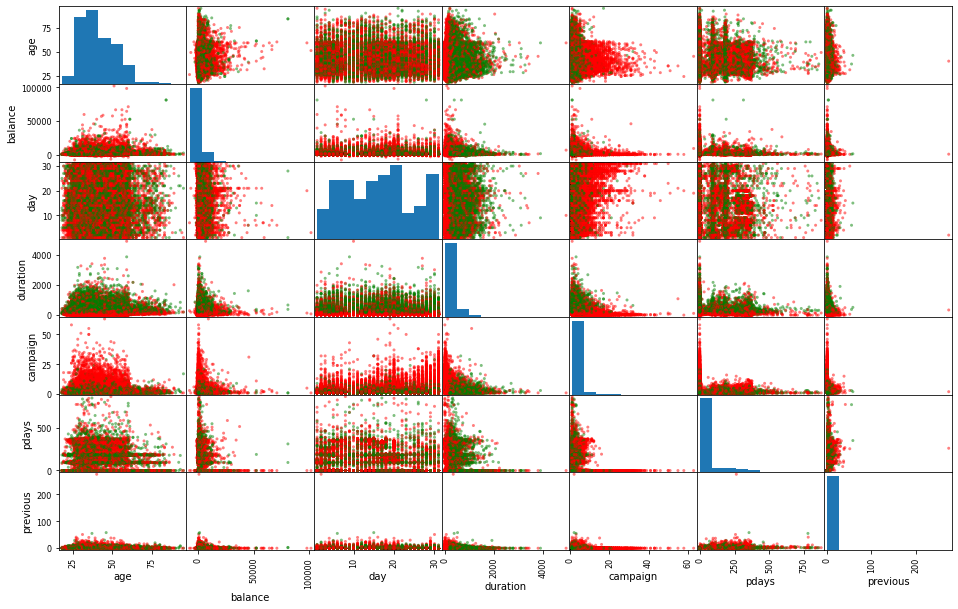

In [1]:
#Disciplina: Solucoes de Mineracao de dados
#--------------------------------------------------------
#Script para a analise exploratoria dos dados (AED) - Credit-screening
#--------------------------------------------------------

# Importando as bibliotecas necessarias
import os
import zipfile
import pandas
import numpy as np
from pandas.plotting import scatter_matrix
import matplotlib.pyplot as plt
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import LabelEncoder
from sklearn import neighbors
from sklearn import tree
plt.rcParams['figure.figsize'] = [16, 10]
pandas.set_option('display.max_columns', None)

# Fazendo o carregamento dos dados
names_dt = ["age","job","marital","education","default","balance","housing","loan","contact","day","month","duration","campaign","pdays","previous","poutcome","y"]
dataset = pandas.read_csv("bank-full.csv", delimiter=";", header="infer")#, na_values='?')
#dataset.to_csv("/content/crx.csv", index=False)

print("Apresentando o shape dos dados (dimenssoes)")
print()
print(dataset.shape)

print()
print("Apresentando os tipos dos atributos")
print()
print(dataset.dtypes)

print()
print("Visualizando o conjunto inicial (head) dos dados, ou mais claramente, os 5 primeiros registros (head(5))")
print()
print(dataset.head(5))

print()
print("Conhecendo os dados estatisticos dos dados carregados (describe)")
print()
print(dataset.describe())

print()
print("Conhecendo a distribuicao dos dados por classes (class distribution)")
#print(dataset.groupby('age').size())
for i in range(0,len(names_dt)):
    print()
    print(dataset.groupby(names_dt[i]).size())
    print()
     

print("Criando gráficos de caixa da distribuição das classes")
dataset.plot(kind='box', subplots=True, layout=(3,3), sharex=False, sharey=False)
plt.show()

print("Criando histogramas dos dados por classes")
dataset.hist()
plt.show()

print("Criando gráficos de dispersão dos dados com paleta de cores")
colors_palette = {"no": 'red', "yes": 'green'}
colors = [colors_palette[c] for c in dataset['y']]
scatter_matrix(dataset, c=colors)
#plt.savefig('tste_fig')
plt.show()

NumExpr defaulting to 8 threads.


DataPrep Report
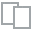
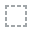
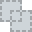
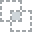
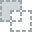
...
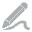
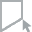
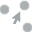
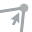
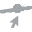

In [2]:
#pip install -U dataprep
import pandas as pd
from dataprep.eda import create_report
df = pd.read_csv("bank-full.csv", delimiter=";", header="infer")
create_report(df)

In [2]:
# Compare Algorithms script

#1. Definicao das bibliotecas
import pandas
import matplotlib.pyplot as plt
from scipy import stats
from sklearn import model_selection
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.model_selection import RandomizedSearchCV
from sklearn import tree
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split
from warnings import filterwarnings
filterwarnings('ignore')

#2. Definicao da semente para geracao de numereos aleatorios
seed = 7


In [3]:
#3. Leitura dos dados
dataframe = pandas.read_csv("bank-full.csv", delimiter=";", header="infer")

In [4]:
from sklearn import preprocessing
from sklearn.preprocessing import LabelEncoder
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import GridSearchCV

#4. A analise exploratoria dos dados realizada em outro script

# ↑↑↑ Ver acima

#Convertendo dados categoricos para dados numericos
le = LabelEncoder()
for column_name in dataframe.columns:
    if dataframe[column_name].dtype == object:
        dataframe[column_name] = le.fit_transform(dataframe[column_name])
    else:
        pass

#5. Preparacao dos dados conduzida em outro script
print("Apresentando o shape dos dados (dimensões)")
print()
print(dataframe.shape)
array = dataframe.values
X = array[:,0:16]
Y = array[:,16]

Apresentando o shape dos dados (dimensões)

(45211, 17)


In [7]:
#6. Divisao da base de dados em treinamento, validacao e teste
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.9, random_state=seed)

In [8]:
#7. Realizar busca com o gridsearch ou randomsearch para encontrar os melhores parametros de cada modelo
# define model (DTC)
model = DecisionTreeClassifier()

# define evaluation
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=seed)

# define search space
space = dict()
space['criterion'] = ['gini', 'entropy']
space['min_samples_split'] = [2,3,5,7]
space['max_depth'] = [3,5,6,7,9,11,13,15,17,19]
space['min_samples_leaf'] = [2, 3]

In [9]:
# define random search (DTC)
randomsearch = RandomizedSearchCV(model, space, n_iter=20, scoring='accuracy', n_jobs=4, cv=cv, random_state=seed)

# execute search (DTC)
rs_result = randomsearch.fit(X_train, Y_train)

# summarize result (DTC)
print('=========Random Search Results==========')
print('Best Score: %s' % rs_result.best_score_)
print('Best Hyperparameters: %s' % rs_result.best_params_)

# Em tempo: os resultados foram muito próximos, e o Random Search foi mais rápido ↓; ele será usado para todos os outros classificadores

=========Random Search Results==========
Best Score: 0.8975898142178984
Best Hyperparameters: {'min_samples_split': 3, 'min_samples_leaf': 3, 'max_depth': 5, 'criterion': 'gini'}


In [10]:
# define grid search (DTC)
gridsearch = GridSearchCV(model, space, scoring='accuracy', n_jobs=-1, cv=cv)

# execute search (DTC)
gs_result = gridsearch.fit(X_train, Y_train)

print('=========Grid Search Results==========')
print('Best Score: %s' % gs_result.best_score_)
print('Best Hyperparameters: %s' % gs_result.best_params_)

=========Grid Search Results==========
Best Score: 0.8976635605305827
Best Hyperparameters: {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 2, 'min_samples_split': 2}


In [12]:
# Fazendo o mesmo procedimento para SVM
svc = SVC()

# defining parameter range for svm
param_grid = {'C': [0.1, 1, 10,],
              'gamma': [1, 0.1, 0.01, 0.001],
              'kernel': ['rbf']}

# define random search for SVM
svc_search = RandomizedSearchCV(svc, param_grid, n_iter=10, scoring='accuracy', n_jobs=4, cv=cv, random_state=seed)

# execute search SVM
result_svc = svc_search.fit(X_train, Y_train)

# summarize result for SVM
print('=========Random Search Results for SVM==========')
print('Best Score: %s' % result_svc.best_score_)
print('Best Hyperparameters: %s' % result_svc.best_params_)

=========Random Search Results for SVM==========
Best Score: 0.8863085819218971
Best Hyperparameters: {'kernel': 'rbf', 'gamma': 0.01, 'C': 0.1}


In [53]:
from sklearn.neighbors import KNeighborsClassifier

# defining parameter range for KNN
par=dict()
par['n_neighbors']=list(range(1,53,2))
par['weights']=['uniform','distance']
par['algorithm']=['auto','ball_tree','kd_tree','brute']
par['leaf_size']=list(range(30,59,2))
par['p']=[1,2]

# Fazendo o mesmo procedimento para KNN
knn = KNeighborsClassifier()

# define random search for KNN
knn_search = RandomizedSearchCV(knn, par, n_iter=10, scoring='accuracy', n_jobs=4, cv=cv, random_state=seed)

# execute search KNN
result_knn = knn_search.fit(X_train, Y_train)

# summarize result for KNN
print('=========Random Search Results for KNN==========')
print('Best Score: %s' % result_knn.best_score_)
print('Best Hyperparameters: %s' % result_knn.best_params_)

=========Random Search Results for KNN==========
Best Score: 0.8905852168760215
Best Hyperparameters: {'weights': 'distance', 'p': 1, 'n_neighbors': 17, 'leaf_size': 32, 'algorithm': 'kd_tree'}


In [70]:
from sklearn.ensemble import RandomForestClassifier

# defining parameter range for RFC
par2=dict()
par2['n_estimators']=list(range(10,200,5))
par2['criterion']=['gini','entropy']
par2['max_features']=['auto','sqrt','log2']
par2['min_samples_leaf']=list(range(2,22))
par2['min_samples_split']=list(range(2,22))
par2['max_leaf_nodes']=list(range(2,52))
par2['bootstrap']=[True,False]
par2['oob_score']=[True,False]

# Fazendo o mesmo procedimento para RFC
rfc = RandomForestClassifier()

# define random search for RFC
rfc_search = RandomizedSearchCV(rfc, par2, n_iter=10, scoring='accuracy', n_jobs=4, cv=cv, random_state=seed)

# execute search RFC
result_rfc = rfc_search.fit(X_train, Y_train)

# summarize result for RFC
print('=========Random Search Results for RFC==========')
print('Best Score: %s' % result_rfc.best_score_)
print('Best Hyperparameters: %s' % result_rfc.best_params_)


=========Random Search Results for RFC==========
Best Score: 0.9033400730625721
Best Hyperparameters: {'oob_score': False, 'n_estimators': 25, 'min_samples_split': 18, 'min_samples_leaf': 12, 'max_leaf_nodes': 49, 'max_features': 'auto', 'criterion': 'gini', 'bootstrap': False}
